# `data_process`

In [ ]:
#default_exp data_process

In [ ]:
#export
import os
import ast
from pathlib import Path
from itertools import groupby
import functools
import mlcrate
from multiprocessing import Pool
from pycocotools import mask as mutils
from pycocotools import _mask as coco_mask
import numpy as np
import pandas as pd
import cv2, PIL
import zlib
import base64
import zipfile
import uuid

from kgl_humanprotein.config.config import *
from kgl_humanprotein.utils.common_util import *

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
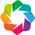

In [ ]:
import holoviews as hv
hv.extension('bokeh')

In [ ]:
dir_data = Path('../../kgl_humanprotein_data/')
dir_models = Path('../../hpa-cell-segmentation-models/')

dir_hpa = dir_data/'hpa-single-cell-image-classification'
dir_trn = dir_hpa/'train'

## Miscellaneous

In [ ]:
#export
def imgids_from_directory(path):
    if isinstance(path, str): 
        path = Path(path)
        
    imgids = set(n.stem.split('_')[0] for n in path.iterdir())
    return list(imgids)

In [ ]:
#export
imgids_testing = [
    '000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0',
    '001838f8-bbca-11e8-b2bc-ac1f6b6435d0',
    '000c99ba-bba4-11e8-b2b9-ac1f6b6435d0',
    'a34d8680-bb99-11e8-b2b9-ac1f6b6435d0',
    '000a9596-bbc4-11e8-b2bc-ac1f6b6435d0']

## Unzipping downloaded image files

Images downloaded individually from Kaggle might be zipped.  The following unzips them and delete the zip files afterwards

In [ ]:
def unzip_zipped_files(src):
    '''
    Unzip all zipped files and remove the zipped version in 
    directory `src`.  Note this assumed each zip file unpacks
    to just a file with the same name except the 'zip' at the end.
    
    Args:
        src (pathlib.Path): Directory containing zipped files.  This
            will also be the directory to unpack to.
    '''
    for fn in src.glob('*.zip'):
        with zipfile.ZipFile(fn) as archive:
            archive.extractall(path=fn.parent)

        if (fn.parent/fn.stem).exists():
            fn.unlink()

In [ ]:
# dir_test = dir_hpa/'test'
# list(dir_test.iterdir())

## Loading image samples

In [ ]:
#export

def read_img(dir_data, image_id, color, image_size=None, suffix='.png'):
    filename = dir_data/f'{image_id}_{color}{suffix}'
    assert filename.exists(), f'not found {filename}'
    
    img = cv2.imread(str(filename), cv2.IMREAD_UNCHANGED)
    
    if image_size is not None:
        img = cv2.resize(img, (image_size, image_size))
        
    if img.max() > 255:
        img_max = img.max()
        img = (img/255).astype('uint8')
        
    return img



def load_RGBY_image(dir_data, image_id, 
                    rgb_only=False, suffix='.png', image_size=None):
    
    red, green, blue = [
        read_img(dir_data, image_id, color, image_size, suffix) 
        for color in ('red', 'green', 'blue')]

    channels = [red, green, blue]
    
    if not rgb_only:
        yellow = read_img(
            dir_data, image_id, "yellow", image_size, suffix)
        channels.append(yellow)
        
    stacked_images = np.transpose(np.array(channels), (1, 2, 0))
    
    return stacked_images

In [ ]:
idx = 3
imgid = imgids_testing[idx]
img = load_RGBY_image(dir_trn, imgid)

In [ ]:
# hv.RGB(img[...,:3])

## Cell segmentation

- https://www.kaggle.com/lnhtrang/hpa-public-data-download-and-hpacellseg#Using-HPA-segmentation-tool

- https://www.kaggle.com/its7171/mmdetection-for-segmentation-training

Install `hpacellseg`:

In [ ]:
# !pip install https://github.com/CellProfiling/HPA-Cell-Segmentation/archive/master.zip

In [ ]:
#export

import hpacellseg.cellsegmentator as cellsegmentator
from hpacellseg.utils import label_cell, label_nuclei
from tqdm import tqdm

class CellSegmentator(cellsegmentator.CellSegmentator):
    def __init__(self, nuc_model, cell_model, *args, **kwargs):
        nuc_model = str(nuc_model)
        cell_model = str(cell_model)
        super().__init__(nuc_model, cell_model, *args, **kwargs)
        
    def __call__(self, red, yellow, blue):
        '''
        `red`: list
          Red images' file paths.
        `yellow`: list
          Yellow images' file paths.
        `blue`: list
          Blue images' file paths.
        '''
        assert len(red) == len(yellow) == len(blue)

        if isinstance(red[0], Path):
            red, yellow, blue = (
                [str(n) for n in fns] 
                for fns in [red, yellow, blue])

        segs_nucl = self.pred_nuclei(blue)
        segs_cell = self.pred_cells([red, yellow, blue])

        masks = []
        for seg_nucl, seg_cell in zip(segs_nucl, segs_cell):
            mask_nucl, mask_cell = label_cell(seg_nucl, seg_cell)
            masks.append((mask_nucl, mask_cell))
            
        return masks

    

def load_segmentator(
    dir_segmentator_models, scale_factor=0.25, device="cuda", 
    padding=True, multi_channel_model=True):
    
    model_nucl = dir_segmentator_models / 'nuclei-model.pth'
    model_cell = dir_segmentator_models / 'cell-model.pth'

    segmentator = CellSegmentator(
        model_nucl, model_cell,
        scale_factor=scale_factor, device=device, padding=padding, 
        multi_channel_model=multi_channel_model)
    
    return segmentator    
    
    
    
def get_cellmask(img, segmentator):
    img_r, img_y, img_b = img[...,0], img[...,3], img[...,2]
    
    masks = segmentator(red=[img_r], yellow=[img_y], blue=[img_b])
    
    _, mask = masks[0]
    return mask

In [ ]:
#export

def segment_image(dir_img=None, imgid=None, segmentator=None):
    img = load_RGBY_image(dir_img, imgid)
    mask = get_cellmask(img, segmentator)
    rles = mask2rles(mask)
    bboxes = rles2bboxes(rles)

    ids = [f'{imgid}_{i}' for i in range(len(rles))]
    df = pd.DataFrame(
        {'Id': ids, 'rle': rles, 'bbox': list(bboxes)})

    return df



def segment_images(dir_img, imgids, segmentator):
    df = pd.DataFrame()
    for imgid in tqdm(imgids, total=len(imgids)):
        df_img = segment_image(dir_img, imgid, segmentator)
        df = df.append(df_img, ignore_index=True)
            
    return df

In [ ]:
segmentator = load_segmentator(dir_models, padding=True)

No GPU found, using CPU.


In [ ]:
mask = get_cellmask(img, segmentator)

In [ ]:
def test_segment_given_filepaths():

    imgids = imgids_testing[:]

    fns_red, fns_yellow, fns_blue = (
        [dir_hpa/'train'/f'{imgid}_{color}.png' for imgid in imgids]
        for color in ('red', 'yellow', 'blue'))
    
    masks = segmentator(red=fns_red, yellow=fns_yellow, blue=fns_blue)

## Masks, RLE and bboxes

In [ ]:
#export

def encode_binary_mask(mask):
    """Converts a binary mask into OID challenge encoding ascii text."""

    # check input mask --
    if mask.dtype != np.bool:
        raise ValueError(
        "encode_binary_mask expects a binary mask, received dtype == %s" %
        mask.dtype)

    mask = np.squeeze(mask)
    if len(mask.shape) != 2:
        raise ValueError(
        "encode_binary_mask expects a 2d mask, received shape == %s" %
        mask.shape)

    # convert input mask to expected COCO API input --
    mask_to_encode = mask.reshape(mask.shape[0], mask.shape[1], 1)
    mask_to_encode = mask_to_encode.astype(np.uint8)
    mask_to_encode = np.asfortranarray(mask_to_encode)

    # RLE encode mask --
    encoded_mask = coco_mask.encode(mask_to_encode)[0]["counts"]

    # compress and base64 encoding --
    binary_str = zlib.compress(encoded_mask, zlib.Z_BEST_COMPRESSION)
    base64_str = base64.b64encode(binary_str)
    return base64_str.decode()



def coco_rle_encode(bmask):
    rle = {'counts': [], 'size': list(bmask.shape)}
    counts = rle.get('counts')
    for i, (value, elements) in enumerate(groupby(bmask.ravel(order='F'))):
        if i == 0 and value == 1:
            counts.append(0)
        counts.append(len(list(elements)))
    return rle

In [ ]:
#export

def mask2rles(mask):
    ids_cell = np.unique(mask)
    
    rles = []
    for id in ids_cell:
        if id == 0: 
            continue

        bmask = np.where(mask == id, 1, 0)
        bmask = np.asfortranarray(bmask).astype(np.uint8)
        rle = mutils.encode(bmask)
        rles.append(rle)
        
    return rles

In [ ]:
rles = mask2rles(mask)

In [ ]:
#export
def rles2bboxes(rles):
    if len(rles) == 0:
        return []

    bboxes = mutils.toBbox(rles)
    bboxes[:,2] += bboxes[:,0]
    bboxes[:,3] += bboxes[:,1]
    
    return bboxes

In [ ]:
bboxes = rles2bboxes(rles)

In [ ]:
#export 

def crop_image(img, bbox, bmask=None):
    '''
    Args:
        img (np.array): Image to be cropped by ``bbox``.
        bbox (np.array): Bounding box in terms of [x0, y0, x1, y1].
        bmask (np.array, np.uint8): Binary mask for the cell.
    '''
    bbox = bbox.astype(np.int16)
    x0, y0, x1, y1 = bbox
    
    crop = img[y0:y1, x0:x1]
    
    if bmask is not None: 
        crop = bmask[y0:y1, x0:x1][...,None] * crop
    
    return crop

In [ ]:
i = 10
bmask = mutils.decode(rles[i])
crop = crop_image(img, bboxes[i], bmask=bmask)

In [ ]:
bmask.dtype

dtype('uint8')

In [ ]:
# fig = (hv.RGB(crop[...,:3]) + 
#        (hv.RGB(img[...,:3]) 
#         * hv.Image(mutils.decode(rles[i]))))

# fig.opts(
#     hv.opts.RGB(yaxis=None, xaxis=None),
#     hv.opts.Image(yaxis=None, xaxis=None, alpha=.5))

In [ ]:
def get_crops(img, bboxes, rles=None):
    if rles is not None:
        assert len(bboxes) == len(rles)
        
    crops = []
    for i, bbox in enumerate(bboxes):

        rle = None if rles is None else rles[i]
        crop = crop_image(img, bbox, rle)
        crops.append(crop)
        
    return crops

In [ ]:
crops = get_crops(img, bboxes, rles=rles)

In [ ]:
# figs = [hv.RGB(crop[...,:3]) for crop in crops]
# figs = [hv.RGB(img[...,:3])] + figs
# fig = hv.Layout(figs).cols(6)

# fig.opts(
#     hv.opts.RGB(yaxis=None, height=150,
#                 xaxis=None, width=150))

In [ ]:
#export

def remove_faint_greens(xs, crops, green_thres=64):
    assert len(xs) == len(crops)
    xs_out = []
    for x, crop in zip(xs, crops):
        if crop[...,1].max() > green_thres:
            xs_out.append(x)
    return xs_out

In [ ]:
len(rles), len(bboxes), len(crops)

(18, 18, 18)

In [ ]:
rles = remove_faint_greens(rles, crops, green_thres=64)
bboxes = remove_faint_greens(bboxes, crops, green_thres=64)
crops = remove_faint_greens(crops, crops, green_thres=64)

In [ ]:
len(rles), len(bboxes), len(crops)

(4, 4, 4)

In [ ]:
#export

def pad_to_square(img):
    h, w, c = img.shape
    if h == w:
        return img
    elif h < w:
        img_padded = np.zeros((w, w, c), dtype=img.dtype)
        offset0 = (w - h) // 2
        offset1 = (w - h) - offset0
        img_padded[offset0:-offset1, :] = img.copy()
    else:
        img_padded = np.zeros((h, h, c), dtype=img.dtype)
        offset0 = (h - w) // 2
        offset1 = (h - w) - offset0
        img_padded[:, offset0:-offset1] = img.copy()
    return img_padded

In [ ]:
# i = 2

# fig = (
#     hv.RGB(crops[i][...,:3]) + 
#     hv.RGB(pad_to_square(crops[i])[...,:3]))
# fig.opts(hv.opts.RGB(yaxis=None, height=100, xaxis=None, width=100))

## Saving RLE

A table listing all the crops and their segmentation information, such as the RLE, is needed.  

In [ ]:
df = pd.DataFrame()
for i in range(len(rles)):
    df = df.append(
        {'rle': rles[i]}, ignore_index=True)
    
df.to_feather('df.feather')

In [ ]:
df_loaded = pd.read_feather('df.feather')

In [ ]:
assert df.iloc[0]['rle']['counts'] == df_loaded.iloc[0]['rle']['counts']

In [ ]:
# hv.Image(mutils.decode(df_loaded.iloc[2].values[0]))

## Segment `train` set

In [ ]:
# def do_segment(idx):
#     imgid = imgids[idx]
#     df = segment_image(
#         dir_img=dir_hpa/'train', imgid=imgid, 
#         segmentator=segmentator)

#     return idx, imgid, df

# pool = Pool(processes=4)
# df_cells = pd.DataFrame()
# for idx, imgid, df in pool.imap(do_segment, range(len(imgids))):
#     df_cells.append(df, ignore_index=True)
#     print(f'{idx + 1}/{len(imgids)}, {imgid}')

In [ ]:
def rle_encode(img, mask_val=1):
    """
    Turns our masks into RLE encoding to easily store them
    and feed them into models later on
    https://en.wikipedia.org/wiki/Run-length_encoding
    
    Args:
        img (np.array): Segmentation array
        mask_val (int): Which value to use to create the RLE
        
    Returns:
        RLE string
    
    """
    dots = np.where(img.T.flatten() == mask_val)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
        
    return ' '.join([str(x) for x in run_lengths])


def rle_decode(rle_string, height, width):
    """ Convert RLE sttring into a binary mask 
    
    Args:
        rle_string (rle_string): Run length encoding containing 
            segmentation mask information
        height (int): Height of the original image the map comes from
        width (int): Width of the original image the map comes from
    
    Returns:
        Numpy array of the binary segmentation mask for a given cell
    """
    rows,cols = height,width
    rle_numbers = [int(num_string) for num_string in rle_string.split(' ')]
    rle_pairs = np.array(rle_numbers).reshape(-1,2)
    img = np.zeros(rows*cols,dtype=np.uint8)
    for index,length in rle_pairs:
        index -= 1
        img[index:index+length] = 255
    img = img.reshape(cols,rows)
    img = img.T
    img = (img / 255).astype(np.uint8)
    return img


In [ ]:
# cell-level train data directory
dir_cell_trn = Path(DATA_DIR) / 'train' 

# cell-level meta data 
# https://www.kaggle.com/dschettler8845/starter-on-how-to-load-rle-masks
pth_cell_trn = dir_cell_trn / 'train.csv'

In [ ]:
df_cell_trn = pd.read_csv(pth_cell_trn)

In [ ]:
df_cell_trn['cell_masks'] = (df_cell_trn['cell_masks']
                             .apply(ast.literal_eval))

In [ ]:
df_cell_trn['bboxes'] = (
    df_cell_trn['bboxes']
    .apply(lambda o: np.array(ast.literal_eval(o))))

In [ ]:
imgids = imgids_from_directory(dir_trn)

In [ ]:
idx = 2

imgid = imgids[idx]
img = load_RGBY_image(dir_trn, imgid)

In [ ]:
rles = df_cell_trn.set_index('ID').loc[imgid,'cell_masks']
bboxes = df_cell_trn.set_index('ID').loc[imgid,'bboxes']

In [ ]:
idx_cell = 8

bmask = rle_decode(rles[idx_cell], *img.shape[:2])
bbox = bboxes[idx_cell]

In [ ]:
img_cell = crop_image(img, bbox, bmask=bmask)
img_cell = pad_to_square(img_cell)

In [ ]:
(
    hv.RGB(img[...,:3]) * hv.Image(bmask).opts(alpha=.5)
    + hv.RGB(img_cell[...,:3])
).opts(
    hv.opts.RGB(yaxis=None, xaxis=None),
    hv.opts.Image(yaxis=None, xaxis=None))

:Layout
   .Overlay.I :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B)
      .Image.I :Image   [x,y]   (z)
   .RGB.I     :RGB   [x,y]   (R,G,B)

In [ ]:
df_trn = pd.read_csv(dir_hpa/'train.csv')

In [ ]:
df_trn.head()

,ID,Label
0,5c27f04c-bb99-11e8-b2b9-ac1f6b6435d0,8|5|0
1,5fb643ee-bb99-11e8-b2b9-ac1f6b6435d0,14|0
2,60b57878-bb99-11e8-b2b9-ac1f6b6435d0,6|1
3,5c1a898e-bb99-11e8-b2b9-ac1f6b6435d0,16|10
4,5b931256-bb99-11e8-b2b9-ac1f6b6435d0,14|0


In [ ]:
df_cells['Image_Id'] = df_cells.apply(
    lambda row: row['Id'].split('_')[0], axis=1)

In [ ]:
df_cells_labeled = pd.merge(
    df_cells, df_trn, 
    left_on='Image_Id', right_on='ID', how='inner')

df_cells_labeled.drop('ID', axis=1, inplace=True)


df_cells_labeled = df_cells_labeled.rename(
    {'Label': 'Target'}, axis=1)

df_cells_labeled['Target'] = df_cells_labeled['Target'].apply(
    lambda o: o.replace('|', ' '))

In [ ]:
df_cells_labeled

,Id,rle,bbox,Image_Id,Target
0,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_0,"{'size': [2048, 2048], 'counts': b'mXlg0;do12N...","[382.0, 70.0, 1658.0, 562.0]",000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,5
1,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_1,"{'size': [2048, 2048], 'counts': b'Pbl3X1gn12N...","[62.0, 410.0, 550.0, 974.0]",000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,5
2,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_2,"{'size': [2048, 2048], 'counts': b'dddj2X1gn12...","[1450.0, 534.0, 2048.0, 943.0]",000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,5
3,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_3,"{'size': [2048, 2048], 'counts': b'YUUi16io12N...","[914.0, 794.0, 1694.0, 1322.0]",000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,5
4,000a9596-bbc4-11e8-b2bc-ac1f6b6435d0_4,"{'size': [2048, 2048], 'counts': b'lUeY3d0[o12...","[1690.0, 815.0, 2022.0, 1374.0]",000a9596-bbc4-11e8-b2bc-ac1f6b6435d0,5
...,...,...,...,...,...
102,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_14,"{'size': [2048, 2048], 'counts': b'U`Q31oo13M;...","[48.0, 1414.0, 533.0, 1682.0]",000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,7 1 2 0
103,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_15,"{'size': [2048, 2048], 'counts': b'P^Ua3`0_o12...","[1810.0, 1418.0, 2048.0, 1698.0]",000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,7 1 2 0
104,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_16,"{'size': [2048, 2048], 'counts': b'lc]j1P1on12...","[934.0, 1506.0, 1366.0, 1958.0]",000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,7 1 2 0
105,000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0_17,"{'size': [2048, 2048], 'counts': b'Rnom2n1Rn10...","[1503.0, 1710.0, 1978.0, 2048.0]",000a6c98-bb9b-11e8-b2b9-ac1f6b6435d0,7 1 2 0
